In [1]:
from tensorflow.keras import datasets

mnist = datasets.mnist

(X_train, y_train), (X_test, y_test) = mnist.load_data()

X_train, X_test = X_train/255.0, X_test/255.0

X_train = X_train.reshape((60000, 28, 28, 1))
X_test = X_test.reshape((10000, 28, 28, 1))

In [2]:
from tensorflow.keras import layers, models

model = models.Sequential([
    layers.Conv2D(32, kernel_size=(5, 5), strides=(1,1), padding='same', activation='relu', input_shape=(28, 28, 1)),
    layers.MaxPool2D(pool_size=(2,2), strides=(2, 2)),
    
    layers.Conv2D(64, (2, 2), activation='relu', padding='same'),
    layers.MaxPool2D(pool_size=(2,2)),
    
    layers.Dropout(0.25),
    layers.Flatten(),
    layers.Dense(1000, activation='relu'),
    layers.Dense(10, activation='softmax')
])

model.summary()

Metal device set to: Apple M1
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 28, 28, 32)        832       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 14, 14, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 14, 14, 64)        8256      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 7, 7, 64)         0         
 2D)                                                             
                                                                 
 dropout (Dropout)           (None, 7, 7, 64)          0         
                                                                 
 flatten (Flatten)        

2022-01-06 16:35:34.783266: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2022-01-06 16:35:34.784166: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


In [3]:
# 학습
import time

model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
start_time = time.time()
hist = model.fit(X_train, y_train, epochs=5, verbose=1, batch_size=1000, validation_data=(X_test, y_test))
print('fit time : ', time.time()-start_time)

2022-01-06 16:35:35.058361: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2022-01-06 16:35:35.211853: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:112] Plugin optimizer for device_type GPU is enabled.


Epoch 1/5
60/60 [==============================] - ETA: 0s - loss: 0.4533 - accuracy: 0.8690

2022-01-06 16:35:41.639160: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:112] Plugin optimizer for device_type GPU is enabled.


60/60 [==============================] - 7s 110ms/step - loss: 0.4533 - accuracy: 0.8690 - val_loss: 0.1292 - val_accuracy: 0.9614
Epoch 2/5
60/60 [==============================] - 6s 99ms/step - loss: 0.1073 - accuracy: 0.9680 - val_loss: 0.0639 - val_accuracy: 0.9801
Epoch 3/5
60/60 [==============================] - 6s 96ms/step - loss: 0.0676 - accuracy: 0.9793 - val_loss: 0.0459 - val_accuracy: 0.9854
Epoch 4/5
60/60 [==============================] - 6s 105ms/step - loss: 0.0552 - accuracy: 0.9832 - val_loss: 0.0408 - val_accuracy: 0.9864
Epoch 5/5
60/60 [==============================] - 6s 93ms/step - loss: 0.0418 - accuracy: 0.9872 - val_loss: 0.0343 - val_accuracy: 0.9884
fit time :  30.674134016036987


In [4]:
score = model.evaluate(X_test, y_test)
print('Test loss : ', score[0])
print('Test Accuracy : ', score[1])

 32/313 [==>...........................] - ETA: 1s - loss: 0.0324 - accuracy: 0.9902

2022-01-06 16:36:05.609403: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:112] Plugin optimizer for device_type GPU is enabled.


313/313 [==============================] - 2s 5ms/step - loss: 0.0343 - accuracy: 0.9884
Test loss :  0.034336358308792114
Test Accuracy :  0.9884000420570374


In [5]:
model.save('saved_model/mnist_cnn')

2022-01-06 16:36:07.322858: W tensorflow/python/util/util.cc:368] Sets are not currently considered sequences, but this may change in the future, so consider avoiding using them.


INFO:tensorflow:Assets written to: saved_model/mnist_cnn/assets


In [6]:
#pb 파일 생성을 위한 변환
import tensorflow as tf

full_model = tf.function(lambda x: model(x))
full_model = full_model.get_concrete_function(
    tf.TensorSpec(model.inputs[0].shape, model.inputs[0].dtype))

In [7]:
# Get frozen ConcreteFunction
from tensorflow.python.framework.convert_to_constants import convert_variables_to_constants_v2

frozen_func = convert_variables_to_constants_v2(full_model)
frozen_func.graph.as_graph_def()

2022-01-06 16:36:07.674499: I tensorflow/core/grappler/devices.cc:75] Number of eligible GPUs (core count >= 8, compute capability >= 0.0): 0 (Note: TensorFlow was not compiled with CUDA or ROCm support)
2022-01-06 16:36:07.674711: I tensorflow/core/grappler/clusters/single_machine.cc:358] Starting new session
2022-01-06 16:36:07.675163: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2022-01-06 16:36:07.675174: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2022-01-06 16:36:07.677756: I tensorflow/core/grappler/optimizers/meta_optimizer.cc:1149] Optimization results for grappler item: graph_to_optimize
  function_optimizer: funct

node {
  name: "x"
  op: "Placeholder"
  attr {
    key: "dtype"
    value {
      type: DT_FLOAT
    }
  }
  attr {
    key: "shape"
    value {
      shape {
        dim {
          size: -1
        }
        dim {
          size: 28
        }
        dim {
          size: 28
        }
        dim {
          size: 1
        }
      }
    }
  }
}
node {
  name: "sequential/conv2d/Conv2D/ReadVariableOp/resource"
  op: "Const"
  attr {
    key: "dtype"
    value {
      type: DT_FLOAT
    }
  }
  attr {
    key: "value"
    value {
      tensor {
        dtype: DT_FLOAT
        tensor_shape {
          dim {
            size: 5
          }
          dim {
            size: 5
          }
          dim {
            size: 1
          }
          dim {
            size: 32
          }
        }
        tensor_content: "\307\007\247=\376\267\241;~\035\311=\024D\007=\036,\224\274%:\312<\231\361\310\273\002\216\304<\313\333\251\275\320xi;m\227\035=\257?\240=\272\347\314\275\206i\013\276\276\

In [8]:
# 레이어 확인 
layers = [op.name for op in frozen_func.graph.get_operations()]
print("-" * 50)
print('Frozen model layers: ')
for layer in layers:
    print(layer)
    
print('-' * 50)
print('fromzen model inputs: ')
print(frozen_func.inputs)
print("frozen model outputs: ")
print(frozen_func.outputs)

--------------------------------------------------
Frozen model layers: 
x
sequential/conv2d/Conv2D/ReadVariableOp/resource
sequential/conv2d/Conv2D/ReadVariableOp
sequential/conv2d/Conv2D
sequential/conv2d/BiasAdd/ReadVariableOp/resource
sequential/conv2d/BiasAdd/ReadVariableOp
sequential/conv2d/BiasAdd
sequential/conv2d/Relu
sequential/max_pooling2d/MaxPool
sequential/conv2d_1/Conv2D/ReadVariableOp/resource
sequential/conv2d_1/Conv2D/ReadVariableOp
sequential/conv2d_1/Conv2D
sequential/conv2d_1/BiasAdd/ReadVariableOp/resource
sequential/conv2d_1/BiasAdd/ReadVariableOp
sequential/conv2d_1/BiasAdd
sequential/conv2d_1/Relu
sequential/max_pooling2d_1/MaxPool
sequential/dropout/Identity
sequential/flatten/Const
sequential/flatten/Reshape
sequential/dense/MatMul/ReadVariableOp/resource
sequential/dense/MatMul/ReadVariableOp
sequential/dense/MatMul
sequential/dense/BiasAdd/ReadVariableOp/resource
sequential/dense/BiasAdd/ReadVariableOp
sequential/dense/BiasAdd
sequential/dense/Relu
sequenti

In [9]:
# pb로 저장
# save frozen graph from frozen ConcreteFunction to hard drive
tf.io.write_graph(graph_or_graph_def=frozen_func.graph, logdir="./frozen_models", name='frozen_graph.pb', as_text=False)

'./frozen_models/frozen_graph.pb'

In [ ]:
# opencv에서 추론
import sys
import numpy as np
import cv2

oldx, oldy = -1, -1

def on_mouse(event, x, y, flags, _):

    global oldx, oldy

    if event == cv2.EVENT_LBUTTONDOWN:
        oldx, oldy = x, y
        
    elif event == cv2.EVENT_LBUTTONUP:
        oldx, oldy = -1, -1
        
    elif event == cv2.EVENT_MOUSEMOVE:
        if flags & cv2.EVENT_FLAG_LBUTTON:
            cv2.line(img, (oldx, oldy), (x, y), (255, 255, 255), 40, cv2.LINE_AA)
            oldx, oldy = x, y
            cv2.imshow('img', img)
            

            
net = cv2.dnn.readNetFromTensorflow('./frozen_models/frozen_graph.pb')

if net.empty():
    print('Network load failed!')
    sys.exit()
    
img = np.zeros((400, 400), np.uint8)

cv2.imshow('img', img)
cv2.setMouseCallback('img', on_mouse)

while True:
    c = cv2.waitKey()
    
    if c == 27:
        break
        
    elif c == ord(' '):
        blob = cv2.dnn.blobFromImage(img, 1/255., (28, 28))
        net.setInput(blob)
        prob = net.forward()
        
        _, maxVal, _, maxLoc = cv2.minMaxLoc(prob)
        digit = maxLoc[0]
        
        print(f"{digit} ({maxVal * 100:4.2f}%)")
        img.fill(0)
        cv2.imshow('img', img)
        
cv2.destroyAllWindows()

3 (99.94%)
4 (100.00%)
7 (99.77%)
5 (92.09%)


## 이미지 판에 적은 숫자 : 3,4,6,1
## 예측 값 : 3,4,7,5
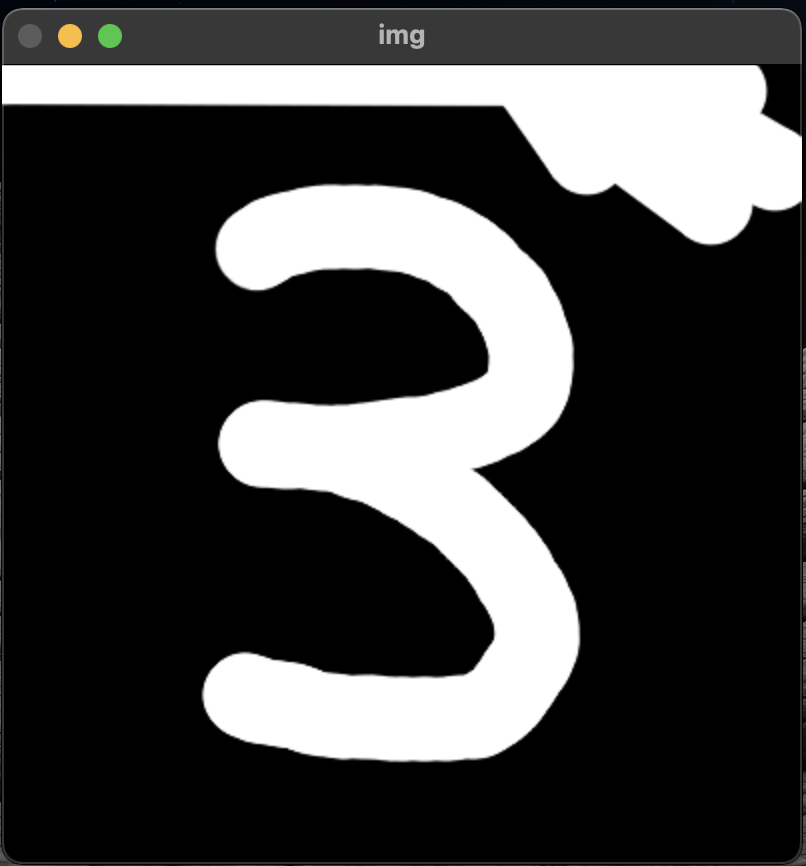
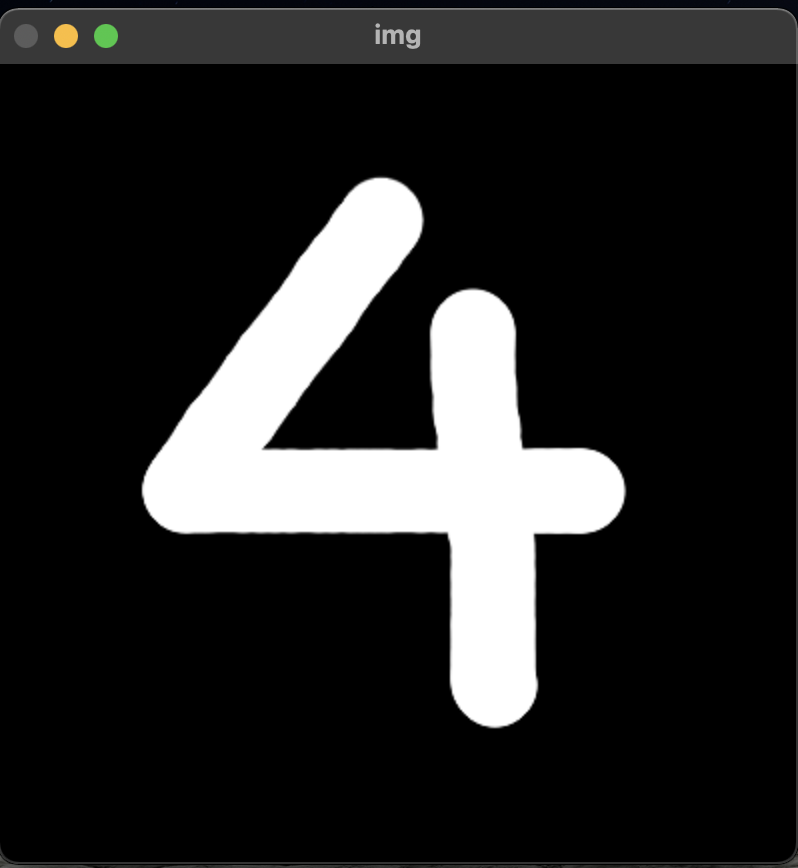
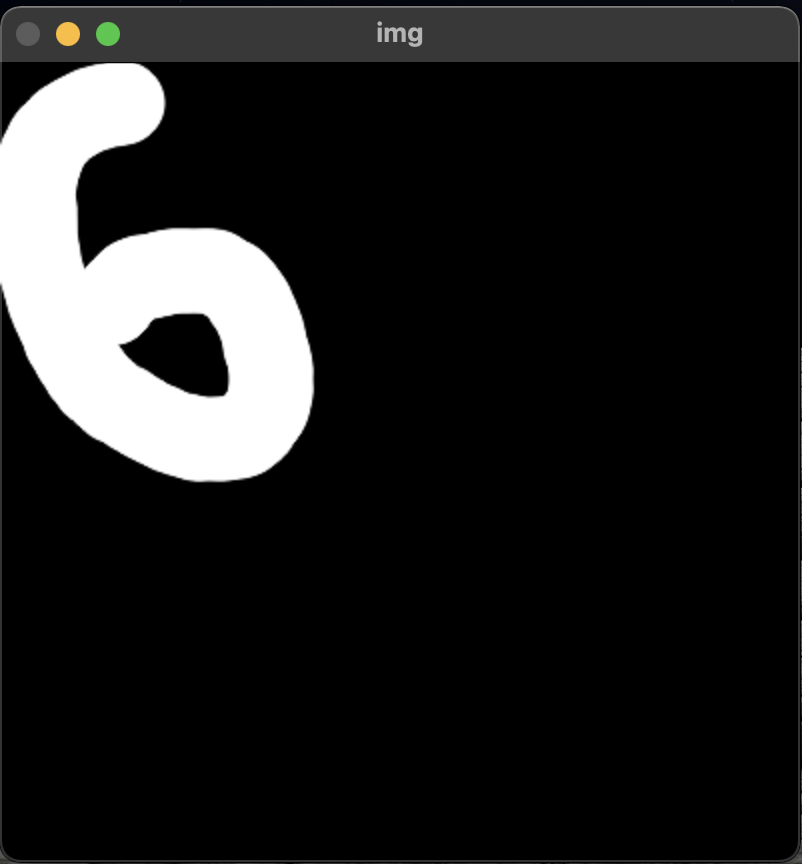
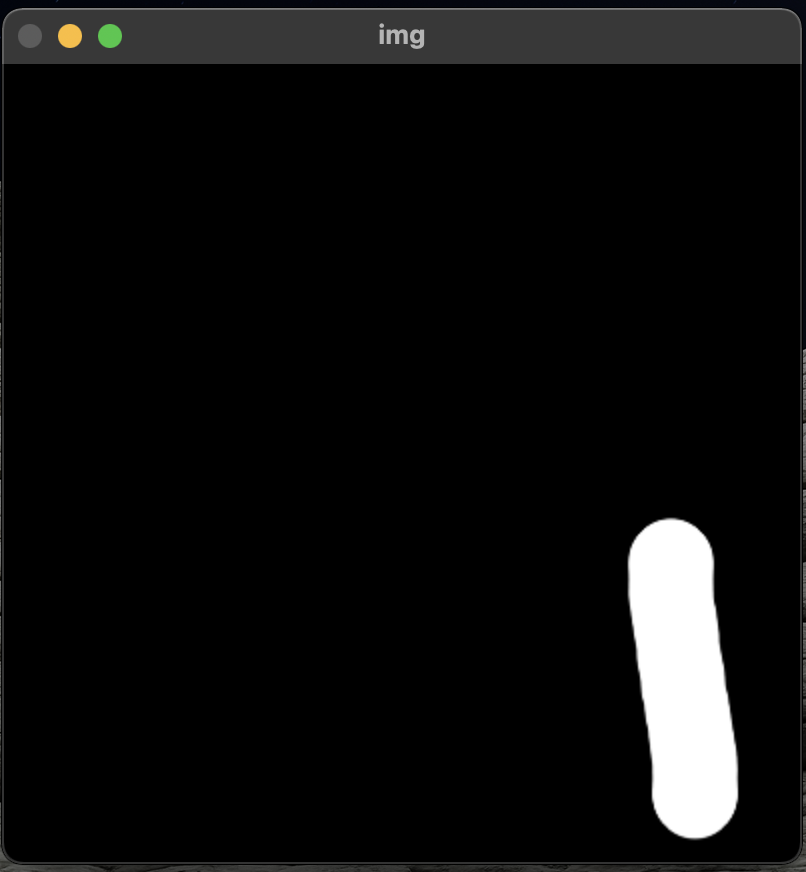

## 문제점 : 이미지 판의 중앙이 아닌 곳에 그리면 인식을 잘 못 한다.
## 해결책 : 모멘트를 이용하여 숫자의 중앙을 찾아보자

In [ ]:
# opencv에서 추론
import sys
import numpy as np
import cv2

oldx, oldy = -1, -1

def on_mouse(event, x, y, flags, _):

    global oldx, oldy

    if event == cv2.EVENT_LBUTTONDOWN:
        oldx, oldy = x, y
        
    elif event == cv2.EVENT_LBUTTONUP:
        oldx, oldy = -1, -1
        
    elif event == cv2.EVENT_MOUSEMOVE:
        if flags & cv2.EVENT_FLAG_LBUTTON:
            cv2.line(img, (oldx, oldy), (x, y), (255, 255, 255), 40, cv2.LINE_AA)
            oldx, oldy = x, y
            cv2.imshow('img', img)
            
def norm_digit(img):
    m = cv2.moments(img)
    #print(m)
    # 모멘텀 구하는 공식
    cx = m['m10'] / m['m00']
    cy = m['m01'] / m['m00']
    h, w = img.shape[:2]
    aff = np.array([[1, 0, w/2 - cx], [0, 1, h/2 - cy]], dtype=np.float32)
    dst = cv2.warpAffine(img, aff, (0,0))
    return dst
    
net = cv2.dnn.readNetFromTensorflow('./frozen_models/frozen_graph.pb')

if net.empty():
    print('Network load failed!')
    sys.exit()
    
img = np.zeros((400, 400), np.uint8)

cv2.imshow('img', img)
cv2.setMouseCallback('img', on_mouse)

while True:
    c = cv2.waitKey()
    
    if c == 27:
        break
        
    elif c == ord(' '):
        blob = cv2.dnn.blobFromImage(norm_digit(img), 1/255., (28, 28))
        net.setInput(blob)
        prob = net.forward()
        
        _, maxVal, _, maxLoc = cv2.minMaxLoc(prob)
        digit = maxLoc[0]
        
        print(f"{digit} ({maxVal * 100:4.2f}%)")
        img.fill(0)
        cv2.imshow('img', img)
        
cv2.destroyAllWindows()

1 (93.40%)
9 (82.48%)
7 (75.06%)
5 (99.61%)


### 입력 숫자 : 1,3,2,5
### 예측 숫자 : 1,9,7,5
### 생각 보다 정확하지 않다.. 